# Spatial & Geospatial Analysis of Flood Events

### Import Modules

In [1]:
import pandas as pd
import numpy as np

### Load Data

In [2]:
input_data_directory = '../../../../data/meteorologia/clean'

alertario = pd.read_csv(f'{input_data_directory}/clima_pluviometro/taxa_precipitacao_alertario_manual.csv', nrows=10000)
estacoes_alertario = pd.read_csv(f'{input_data_directory}/clima_pluviometro/estacoes_alertario.csv')
ocorrencias = pd.read_csv(f'{input_data_directory}/adm_cor_comando/ocorrencias.csv')
pops = pd.read_csv('../../data/raw/adm_cor_comando/pops.csv', index_col=0)

### Preprocessing `taxa_precipitacao_alertario`

In [3]:
# Convert datetime data type fields
alertario['horario'] = pd.to_timedelta(alertario['horario'])
alertario['data_particao'] = pd.to_datetime(alertario['data_particao'])
alertario['timestamp'] = pd.to_datetime(alertario['timestamp'])

# Map station name and coordinates
station_name_map = estacoes_alertario.set_index('id_estacao')['estacao']
alertario['estacao'] = alertario['id_estacao'].map(station_name_map)

# station_latitude_map = estacoes_alertario.set_index('id_estacao')['latitude']
# alertario['latitude'] = alertario['id_estacao'].map(station_latitude_map)

# station_longitude_map = estacoes_alertario.set_index('id_estacao')['longitude']
# alertario['longitude'] = alertario['id_estacao'].map(station_longitude_map)

# Reorder columns
alertario = alertario[[
    'primary_key',
    'id_estacao',
    'estacao',
    # 'latitude',
    # 'longitude',
    'horario',
    'data_particao',
    'timestamp',
    'acumulado_chuva_15_min',
    'acumulado_chuva_1_h',
    'acumulado_chuva_4_h',
    'acumulado_chuva_24_h',
    'acumulado_chuva_96_h'
]]

### Preprocessing `ocorrencias`

In [4]:
# Convert datetime data type fields
ocorrencias['data_inicio'] = pd.to_datetime(ocorrencias['data_inicio'])
ocorrencias['data_fim'] = pd.to_datetime(ocorrencias['data_fim'])

# Map event type
ocorrencias['tipo'] = ocorrencias['id_pop'].map(pops.set_index('id')['titulo'])

### Filter flood events

In [5]:
flood_types = [
    "Bolsão d'água em via",
    'Alagamentos e enchentes',
    "Lâmina d'água"
]

ocorrencias = ocorrencias[ocorrencias['tipo'].isin(flood_types)]

---

## Data Visualization of Flood Events

# Data Visualization of Flood Events in Rio de Janeiro

This Jupyter Notebook implements a comprehensive data visualization plan to analyze flood events in Rio de Janeiro, using the dataset loaded into the `ocorrencias` variable. We will use Plotly for creating interactive and informative visualizations.

## 1. Data Overview & Preprocessing

In this section, we will load the necessary libraries, inspect the dataset, and perform data cleaning and feature engineering steps as outlined in the plan.

In [6]:
# !pip install wordcloud
# !pip install nltk
# !pip install cartopy
# !pip install geopandas
# !pip install rasterio
# !pip install contextily

import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# print("First 5 rows of the DataFrame:")
# print(ocorrencias.head())
# print("\nDataFrame Info:")
# print(ocorrencias.info())

### Data Cleaning & Transformation

- Convert “data_inicio” and “data_fim” to datetime objects.
- Compute event duration (in minutes) as a new column.
- Derive additional temporal features (hour, day of week, month, season).
- Handle missing values in `prazo_num` (filling with 0 for now as example).

In [7]:
ocorrencias['duration_seconds'] = (ocorrencias['data_fim'] - ocorrencias['data_inicio']).dt.total_seconds()
ocorrencias['duration_minutes'] = ocorrencias['duration_seconds'] / 60

ocorrencias['hour_start'] = ocorrencias['data_inicio'].dt.hour
ocorrencias['day_of_week'] = ocorrencias['data_inicio'].dt.day_name()
ocorrencias['month'] = ocorrencias['data_inicio'].dt.month_name()
ocorrencias['month_num'] = ocorrencias['data_inicio'].dt.month
ocorrencias['year'] = ocorrencias['data_inicio'].dt.year
ocorrencias['day_of_month'] = ocorrencias['data_inicio'].dt.day
ocorrencias['date'] = pd.to_datetime(ocorrencias['data_inicio'].dt.date)

# Define seasons (for Rio de Janeiro - approximate)
def get_season(month):
    if month in [12, 1, 2]:
        return 'Summer'
    elif month in [3, 4, 5]:
        return 'Autumn'
    elif month in [6, 7, 8]:
        return 'Winter'
    else:
        return 'Spring'

ocorrencias['season'] = ocorrencias['month_num'].apply(get_season)

# Handle missing values in 'prazo_num' - Fill with 0 for demonstration
ocorrencias['prazo_num'] = ocorrencias['prazo_num'].fillna(0)

print("\nDataFrame after preprocessing:")
display(ocorrencias.head())


DataFrame after preprocessing:


,id_pop,id_evento,bairro,data_inicio,data_fim,prazo,descricao,gravidade,latitude,longitude,...,duration_seconds,duration_minutes,hour_start,day_of_week,month,month_num,year,day_of_month,date,season
622,5.0,66955,Caju,2021-10-15 22:11:46+00:00,2021-10-15 22:16:00+00:00,Curto,"Av. rio de janeiro, 675 - caju",Baixo,-22.891448,-43.214630,...,254.0,4.233333,22,Friday,October,10,2021,15,2021-10-15,Spring
623,5.0,67278,Lagoa,2021-10-24 16:34:17+00:00,2021-10-24 19:52:44+00:00,Curto,"Av. epitácio pessoa, alt. r. garcia d'avila- l...",Baixo,-22.980942,-43.208720,...,11907.0,198.450000,16,Sunday,October,10,2021,24,2021-10-24,Spring
624,5.0,67280,Lagoa,2021-10-24 16:45:02+00:00,2021-10-24 18:19:05+00:00,Curto,"Av. borges de medeiros, alt. r. batista da cos...",Baixo,-22.965323,-43.215881,...,5643.0,94.050000,16,Sunday,October,10,2021,24,2021-10-24,Spring
625,5.0,67279,Lagoa,2021-10-24 16:39:46+00:00,2021-10-24 17:50:16+00:00,Curto,"Viaduto saint hilaire, alt. alça de acesso av....",Baixo,-22.961056,-43.204173,...,4230.0,70.500000,16,Sunday,October,10,2021,24,2021-10-24,Spring
626,5.0,66613,Penha,2021-10-03 17:29:02+00:00,2021-10-03 18:15:23+00:00,Curto,Rua ibiapina - alt. r. monsenhor alves rocha -...,Baixo,-22.841611,-43.276258,...,2781.0,46.350000,17,Sunday,October,10,2021,3,2021-10-03,Spring


### Data Segmentation

- Create subsets for each event type.

In [8]:
bolsao_dagua = ocorrencias[ocorrencias['tipo'] == "Bolsão d'água em via"]
alagamentos = ocorrencias[ocorrencias['tipo'] == "Alagamentos e enchentes"]
lamina_dagua = ocorrencias[ocorrencias['tipo'] == "Lâmina d'água"]

print("\nNumber of 'Bolsão d'água em via' events:", len(bolsao_dagua))
print("Number of 'Alagamentos e enchentes' events:", len(alagamentos))
print("Number of 'Lâmina d'água' events:", len(lamina_dagua))


Number of 'Bolsão d'água em via' events: 4217
Number of 'Alagamentos e enchentes' events: 172
Number of 'Lâmina d'água' events: 185


---

## 2. Spatial & Geospatial Visualizations

### Scatter Maps

- Plot events on a map of Rio de Janeiro using latitude and longitude.
- Use color coding or different markers for each event type.

/tmp/ipykernel_328634/220299494.py:79: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



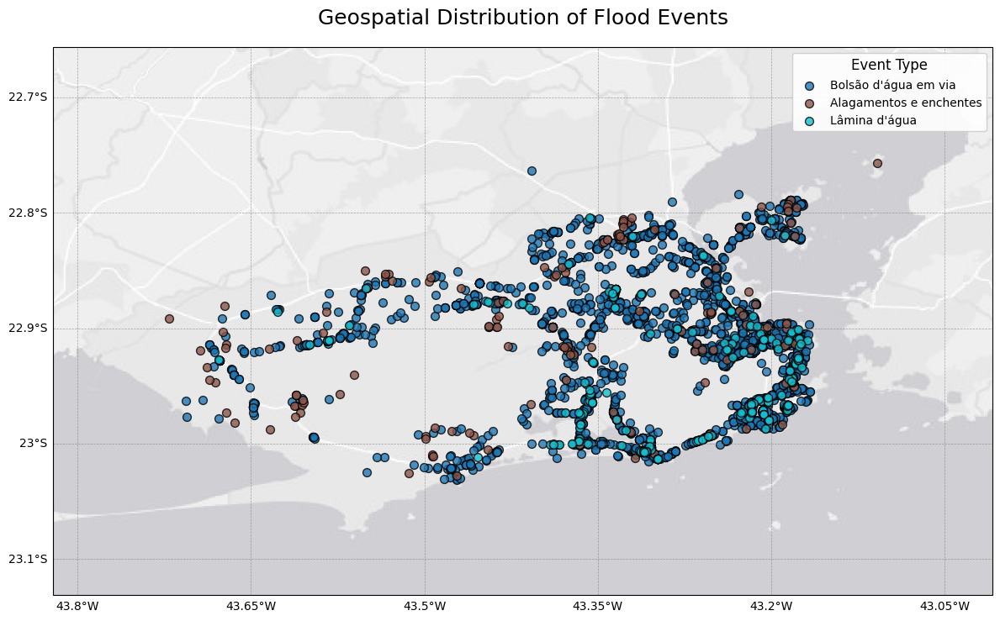

In [20]:
import matplotlib.pyplot as plt
import cartopy.io.img_tiles as cimgt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.cm as cm

class CustomTiles(cimgt.OSM):
    def __init__(self, url, attribution=None):
        super().__init__()
        self._url_template = url
        self.attribution = attribution or "Tile data attribution not set"

    def _image_url(self, tile):
        x, y, z = tile  # Unpack the tile tuple
        return self._url_template.format(z=z, x=x, y=y, s='a')
        
# Dynamically calculate extent based on data with a small padding.
lon_min = ocorrencias['longitude'].min() - 0.1
lon_max = ocorrencias['longitude'].max() + 0.1
lat_min = ocorrencias['latitude'].min() - 0.1
lat_max = ocorrencias['latitude'].max() + 0.1

# Set up a high-resolution figure for publication quality.
fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={'projection': ccrs.PlateCarree()})

# Set the extent to focus on the area where the events are located.
ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Instead of adding individual physical features, add a high-resolution basemap.
# You can choose from several tile providers; here we use Stamen's terrain background.
# tiler = cimgt.OSM()  

# Choose a clean tile provider
# tile_url = "https://tile.openstreetmap.org/{z}/{x}/{y}.png"
# tile_url = "https://{s}.tile.openstreetmap.fr/hot/{z}/{x}/{y}.png"
# tile_url = "https://{s}.tile.opentopomap.org/{z}/{x}/{y}.png"
tile_url = "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
attribution = "© OpenStreetMap contributors"

# Create tile object
tiler = CustomTiles(tile_url, attribution=attribution)
crs = tiler.crs

ax.add_image(tiler, 10)  # Adjust the zoom level as needed.

'''
# --- Neighborhood Boundaries ---
# Replace with your neighborhoods shapefile.
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path)

neighborhoods_gdf = neighborhoods_gdf.to_crs(epsg=4326)
# neighborhoods_gdf = neighborhoods_gdf.to_crs("EPSG:3857")

neighborhoods_gdf.boundary.plot(
    ax=ax,
    edgecolor='black',
    linewidth=0.5,
    label="Neighborhood Boundaries",
#     facecolor='none',     # Fill color
#     edgecolor='#303030',
#     linewidth=1.2,
#     linestyle='-',
    alpha=0.95,
)

ax.legend(loc='lower right', fontsize=10, frameon=True, edgecolor='gray')
'''

# Add gridlines with labels for better geographic reference.
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.7, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 10}
gl.ylabel_style = {'size': 10}

# Group the data by 'tipo' and assign each group a unique color.
unique_types = ocorrencias['tipo'].unique()
cmap = cm.get_cmap('tab10', len(unique_types))
colors = {etype: cmap(i) for i, etype in enumerate(unique_types)}

# Plot each event type with enhanced markers.
for etype in unique_types:
    subset = ocorrencias[ocorrencias['tipo'] == etype]
    ax.scatter(subset['longitude'], subset['latitude'],
               label=etype,
               color=colors[etype],
               s=50,           # Increased marker size for better visibility.
               edgecolor='k',  # Black edges for enhanced contrast.
               alpha=0.8,
               transform=ccrs.PlateCarree())

# Enhance and configure the legend.
legend = ax.legend(title='Event Type', loc='upper right', frameon=True, fontsize=10, title_fontsize=12)
legend.get_frame().set_alpha(0.9)
plt.title('Geospatial Distribution of Flood Events', fontsize=18, pad=20)
plt.tight_layout()

plt.savefig(
    "maps/flood_distribution_esri_wlgb.png",     # or .pdf, .svg, .tiff for vector/raster as needed
    dpi=300,                    # High resolution (300+ DPI for print quality)
    bbox_inches='tight',       # Trim extra whitespace
    pad_inches=0.1,            # Optional padding around the figure
    transparent=True           # Keeps background transparent if needed
)
plt.show()

### Density Heatmaps (Kernel Density Estimation Maps)

- Create heatmaps showing concentration areas (hotspots) of events across the city.

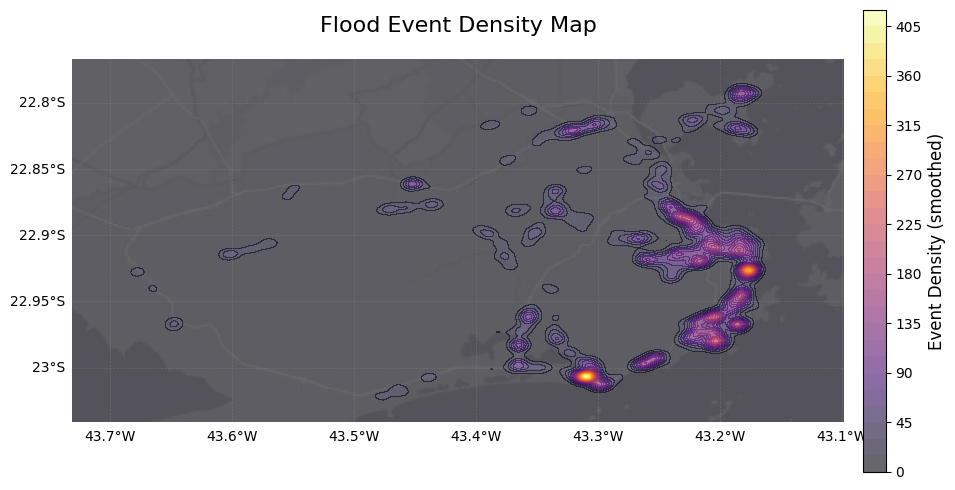

In [11]:
import matplotlib.pyplot as plt
import cartopy.io.img_tiles as cimgt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import numpy as np
from scipy.stats import gaussian_kde

class CustomTiles(cimgt.OSM):
    def __init__(self, url, attribution=None):
        super().__init__()
        self._url_template = url
        self.attribution = attribution or "Tile data attribution not set"

    def _image_url(self, tile):
        x, y, z = tile  # Unpack the tile tuple
        return self._url_template.format(z=z, x=x, y=y, s='a')

# Load and filter your data
subset = ocorrencias[ocorrencias['duration_minutes'] < 3000].dropna(subset=['latitude', 'longitude'])
x = subset['longitude'].values
y = subset['latitude'].values

# KDE computation
xy = np.vstack([x, y])
kde = gaussian_kde(xy, bw_method=0.05)

xmin, xmax = x.min() - 0.01, x.max() + 0.01
ymin, ymax = y.min() - 0.01, y.max() + 0.01 - 0.02
xx, yy = np.mgrid[xmin:xmax:1000j, ymin:ymax:1000j]
positions = np.vstack([xx.ravel(), yy.ravel()])
density = kde(positions).reshape(xx.shape)

# Load neighborhood boundaries
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path).to_crs(epsg=4326)

# Base map features (subtle)
# Choose a clean tile provider
# tile_url = "https://tile.openstreetmap.org/{z}/{x}/{y}.png"
# tile_url = "https://{s}.tile.openstreetmap.fr/hot/{z}/{x}/{y}.png"
# tile_url = "https://{s}.tile.opentopomap.org/{z}/{x}/{y}.png"
tiler = CustomTiles(
    "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}",
    attribution="© OpenStreetMap contributors"
)
crs = tiler.crs

# Plot setup
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw={'projection': crs})
ax.set_extent([xmin, xmax, ymin, ymax])
ax.add_image(tiler, 10)  # Adjust the zoom level as needed.

# Add gridlines with labels for better geographic reference.
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 10}
gl.ylabel_style = {'size': 10}

# Density heatmap
density_map = ax.contourf(xx, yy, density, levels=30, cmap='inferno', alpha=0.6, transform=ccrs.PlateCarree())

# Neighborhood outlines
# neighborhoods_gdf.boundary.plot(ax=ax, edgecolor='black', linewidth=1.2, alpha=0.8)

# Colorbar
cbar = fig.colorbar(density_map, ax=ax, orientation='vertical', pad=0.02, shrink=0.5)
cbar.set_label('Event Density (smoothed)', fontsize=12)

# Final styling
ax.set_title('Flood Event Density Map', fontsize=16, pad=20)
ax.set_axis_off()

# Save for publication
plt.savefig("maps/event_density_map.png", dpi=600, bbox_inches='tight')
plt.show()


### Choropleth Maps

- A map coloring neighborhoods based on event frequency.
- **Note:** Choropleth maps require geospatial boundaries. This involves merging with an external GeoJSON or shapefile. Skipping for now but mentioning the possibility.

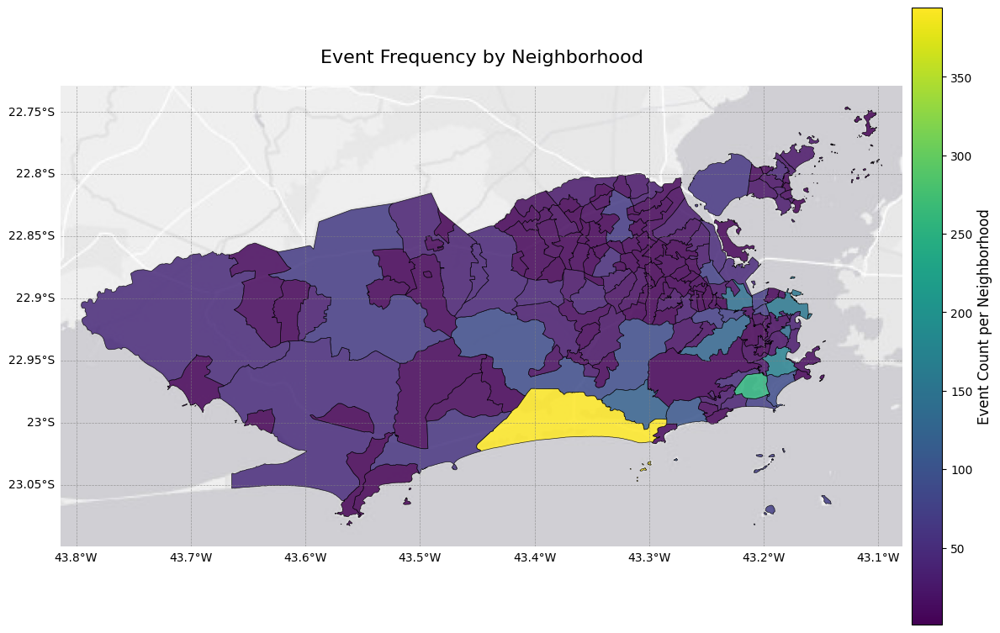

In [11]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib as mpl
import contextily as ctx
import numpy as np
from matplotlib.colors import Normalize
from cartopy.io.img_tiles import GoogleTiles
import cartopy.crs as ccrs
import cartopy.io.img_tiles as cimgt
import cartopy.feature as cfeature
from shapely.geometry import Point
import pandas as pd

class CustomTiles(cimgt.OSM):
    def __init__(self, url, attribution=None):
        super().__init__()
        self._url_template = url
        self.attribution = attribution or "Tile data attribution not set"

    def _image_url(self, tile):
        x, y, z = tile  # Unpack the tile tuple
        return self._url_template.format(z=z, x=x, y=y, s='a')
        
# --- Load Event Points ---
# Ensure 'ocorrencias' is a DataFrame with lat/lon columns
gdf_events = gpd.GeoDataFrame(ocorrencias, 
                               geometry=gpd.points_from_xy(ocorrencias.longitude, ocorrencias.latitude),
                               crs="EPSG:4326").to_crs(epsg=3857)

# --- Load Neighborhoods ---
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path)
neighborhoods_gdf = neighborhoods_gdf.to_crs(epsg=3857)  # match tile CRS

# --- Spatial Join: Count Events per Neighborhood ---
# Perform spatial join while preserving neighborhood index
neighborhoods_gdf = neighborhoods_gdf.reset_index().rename(columns={"index": "neigh_index"})
joined = gpd.sjoin(neighborhoods_gdf, gdf_events, how="left", predicate="contains")

# Count events per neighborhood using 'neigh_index'
counts = joined["neigh_index"].value_counts()
neighborhoods_gdf["event_count"] = neighborhoods_gdf["neigh_index"].map(counts).fillna(0)

tile_url = "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
attribution = "© OpenStreetMap contributors"

# Create tile object
tiler = CustomTiles(tile_url, attribution=attribution)
crs = tiler.crs

# Set the extent to focus on the area where the events are located.
xmin, ymin, xmax, ymax = neighborhoods_gdf.total_bounds
pad = 2000

# --- Plotting ---
fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs})
ax.set_extent([xmin - pad, xmax + pad, ymin - pad, ymax + pad], crs=crs)
ax.add_image(tiler, 10)  # Adjust the zoom level as needed.

# Add gridlines with labels for better geographic reference.
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.7, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 10}
gl.ylabel_style = {'size': 10}

neighborhoods_gdf.plot(
    ax=ax,
    column="event_count",
    cmap="viridis",
    linewidth=0.5,
    edgecolor="black",
    alpha=0.85,
    legend=False
)


# Add colorbar
sm = plt.cm.ScalarMappable(cmap="viridis", norm=Normalize(vmin=neighborhoods_gdf["event_count"].min(),
                                                           vmax=neighborhoods_gdf["event_count"].max()))
sm._A = []
cbar = fig.colorbar(sm, ax=ax, orientation="vertical", fraction=0.035, pad=0.01)
cbar.set_label("Event Count per Neighborhood", fontsize=12)

# Aesthetic tweaks
ax.set_title("Event Frequency by Neighborhood", fontsize=16, pad=20)
ax.set_axis_off()
plt.tight_layout()

# Save output
plt.savefig("maps/choropleth_event_frequency.png", dpi=600, bbox_inches='tight')
plt.show()


### Cloropeth Map with fixed intervals

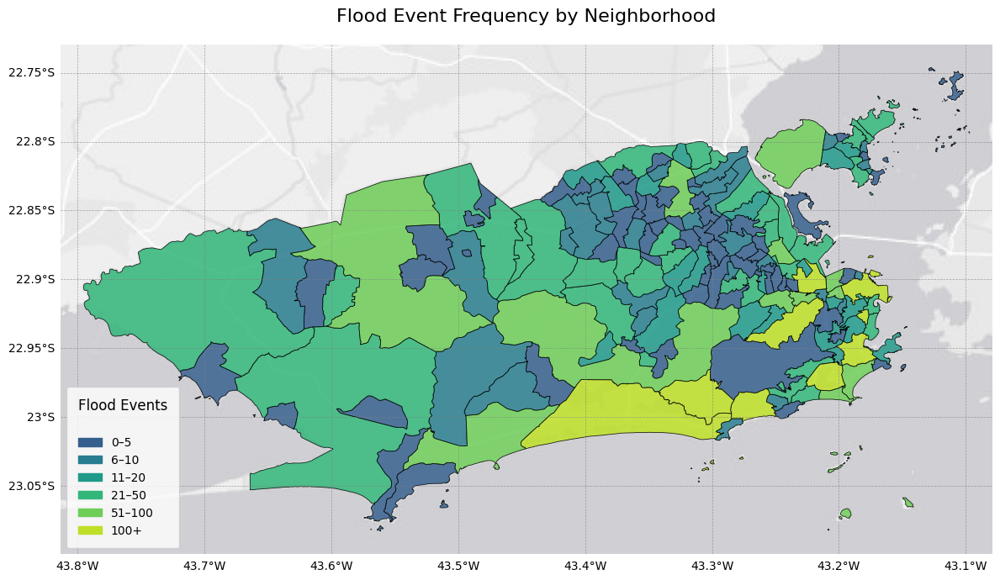

In [12]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import Normalize
import numpy as np

# Set the extent to focus on the area where the events are located.
xmin, ymin, xmax, ymax = neighborhoods_gdf.total_bounds
tile_url = "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
attribution = "© OpenStreetMap contributors"

# Create tile object
tiler = CustomTiles(tile_url, attribution=attribution)
crs = tiler.crs

# Create the figure and axis with the correct projection
fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs})
pad = 2000
ax.set_extent([xmin - pad, xmax + pad, ymin - pad, ymax + pad], crs=crs)
ax.add_image(tiler, 10)  # Adjust the zoom level as needed.

# Add gridlines with labels for better geographic reference.
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.7, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 10}
gl.ylabel_style = {'size': 10}

# --- Load Neighborhoods ---
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path)
neighborhoods_gdf = neighborhoods_gdf.to_crs(epsg=3857)  # match tile CRS

# --- Spatial Join: Count Events per Neighborhood ---
# Perform spatial join while preserving neighborhood index
neighborhoods_gdf = neighborhoods_gdf.reset_index().rename(columns={"index": "neigh_index"})
joined = gpd.sjoin(neighborhoods_gdf, gdf_events, how="left", predicate="contains")

# Count events per neighborhood using 'neigh_index'
counts = joined["neigh_index"].value_counts()
neighborhoods_gdf["event_count"] = neighborhoods_gdf["neigh_index"].map(counts).fillna(0)

# --- Bin the event counts into categories ---
bins = [0, 5, 10, 20, 50, 100, np.inf]
labels = ["0–5", "6–10", "11–20", "21–50", "51–100", "100+"]
neighborhoods_gdf["count_bin"] = pd.cut(neighborhoods_gdf["event_count"], bins=bins, labels=labels, include_lowest=True)

# --- Define a color palette ---
colors = plt.cm.viridis(np.linspace(0.3, 0.9, len(labels)))
color_map = dict(zip(labels, colors))

# --- Plot each bin separately to control styling ---
for label in labels:
    subset = neighborhoods_gdf[neighborhoods_gdf["count_bin"] == label]
    if not subset.empty:
        subset.plot(ax=ax,
                    color=color_map[label],
                    edgecolor='black',
                    linewidth=0.6,
                    alpha=0.85)

# --- Add legend ---
legend_handles = [mpatches.Patch(color=color_map[label], label=label) for label in labels]
ax.legend(handles=legend_handles,
          title="Flood Events\n",
          loc='lower left',
          fontsize=10,
          title_fontsize=12,
          frameon=True,
          borderpad=1,
          alignment='left')

# --- Title and finishing touches ---
ax.set_title("Flood Event Frequency by Neighborhood", fontsize=16, pad=20)
ax.set_axis_off()
plt.tight_layout()

# --- Save and show ---
plt.savefig("maps/choropleth_event_frequency_legend.png", dpi=600, bbox_inches='tight')
plt.show()


### Event Type Comparison Maps

- Small multiples (or faceted maps) for each event type to visually compare their spatial distributions.

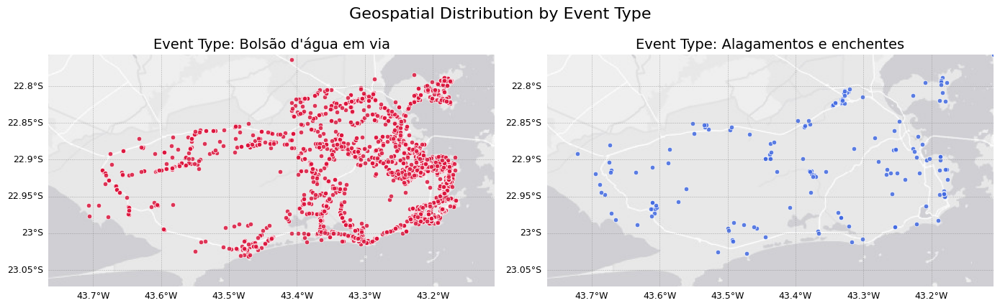

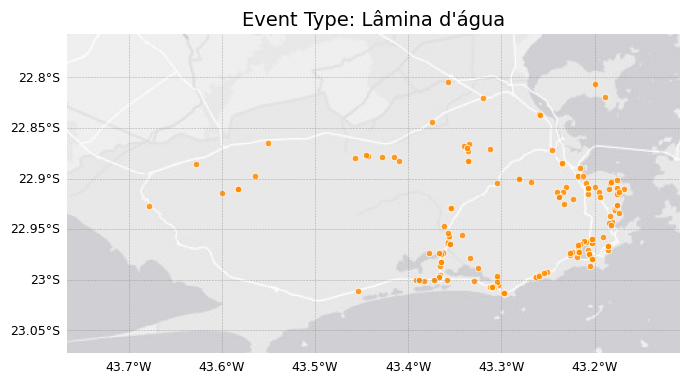

In [30]:
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.io.img_tiles as cimgt
from shapely.geometry import Point

# --- Custom Tile Class ---
class CustomTiles(cimgt.OSM):
    def __init__(self, url, attribution=None):
        super().__init__()
        self._url_template = url
        self.attribution = attribution or "Tile data attribution not set"

    def _image_url(self, tile):
        x, y, z = tile
        return self._url_template.format(z=z, x=x, y=y, s='a')

# --- Tile Provider ---
tile_url = "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
tiler = CustomTiles(tile_url, attribution="© Esri, OpenStreetMap contributors")
crs = tiler.crs

# --- Prepare Event GeoDataFrame ---
gdf_events = gpd.GeoDataFrame(
    ocorrencias,
    geometry=gpd.points_from_xy(ocorrencias.longitude, ocorrencias.latitude),
    crs="EPSG:4326"
).to_crs(epsg=3857)

# --- Get Shared Map Extent ---
xmin, ymin, xmax, ymax = gdf_events.total_bounds

# --- Separate Event Types ---
unique_types = gdf_events['tipo'].dropna().unique()
colors = ['crimson', 'royalblue', 'darkorange']

# --- Figure 1: Two Plots Side by Side ---
fig1, axes1 = plt.subplots(1, 2, figsize=(14, 7), subplot_kw={'projection': crs})
for i, tipo in enumerate(unique_types[:2]):
    ax = axes1[i]
    ax.set_title(f"Event Type: {tipo}", fontsize=14)
    pad = 0
    ax.set_extent([xmin - pad - 5000, xmax + pad, ymin - pad - 5000, ymax + pad], crs=crs)
    ax.add_image(tiler, 10)

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.4, color='gray', alpha=0.6, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = {'size': 9}
    gl.ylabel_style = {'size': 9}

for i, tipo in enumerate(unique_types[:2]):
    ax = axes1[i]

    gdf_events[gdf_events['tipo'] == tipo].plot(
        ax=ax,
        markersize=22,
        color=colors[i],
        alpha=0.85,
        edgecolor='white',
        linewidth=0.6,
        transform=crs
    )
    ax.set_axis_off()

fig1.suptitle("Geospatial Distribution by Event Type", fontsize=16, y=0.80)
plt.tight_layout()
plt.savefig("maps/event_type_part1.png", dpi=600, bbox_inches='tight')
plt.show()

# --- Figure 2: Single Plot Centered ---
fig2, ax2 = plt.subplots(1, 1, figsize=(7, 7), subplot_kw={'projection': crs})
tipo = unique_types[2]
ax2.set_title(f"Event Type: {tipo}", fontsize=14)
pad = 0
ax2.set_extent([xmin - pad - 5000, xmax + pad, ymin - pad - 5000, ymax + pad], crs=crs)
ax2.add_image(tiler, 10)

gl = ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.4, color='gray', alpha=0.6, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 9}
gl.ylabel_style = {'size': 9}

gdf_events[gdf_events['tipo'] == tipo].plot(
    ax=ax2,
    markersize=22,
    color=colors[2],
    alpha=0.85,
    edgecolor='white',
    linewidth=0.6,
    transform=crs
)
ax2.set_axis_off()

# fig2.suptitle("Geospatial Distribution by Event Type (Part 2)", fontsize=16, y=0.96)
plt.tight_layout()
plt.savefig("maps/event_type_part2.png", dpi=600, bbox_inches='tight')
plt.show()

### Animated Maps

- Develop a time-lapse map to show the evolution of flood events over time.

In [14]:
fig_animated_geo = px.scatter_geo(ocorrencias, lat='latitude', lon='longitude', animation_frame=ocorrencias['data_inicio'].dt.strftime('%Y-%m-%d'),
                                   color='tipo', scope='south america',
                                   center={'lat': ocorrencias['latitude'].mean(), 'lon': ocorrencias['longitude'].mean()},
                                   title='Animated Geospatial Distribution of Events Over Time')
fig_animated_geo.show()

### Bubble Maps

- Plot events with bubble sizes representing duration, overlaid on time or maps.

#### Bubble Map with Plotly

In [15]:
import plotly.graph_objects as go
import plotly.express as px

ocorrencias_cut = ocorrencias[ocorrencias['duration_minutes'] < 10000]

# Color map
event_types = ocorrencias_cut['tipo'].unique()
colors = px.colors.qualitative.Plotly
color_map = {tipo: colors[i % len(colors)] for i, tipo in enumerate(event_types)}

# Map bounds
padding = 0.02
lat_min = ocorrencias_cut['latitude'].min() - padding
lat_max = ocorrencias_cut['latitude'].max() + padding
lon_min = ocorrencias_cut['longitude'].min() - padding
lon_max = ocorrencias_cut['longitude'].max() + padding
center = {"lat": (lat_min + lat_max) / 2, "lon": (lon_min + lon_max) / 2}

# Bubble Map
fig_bubble_map = go.Figure()

for tipo in event_types:
    subset = ocorrencias_cut[ocorrencias_cut['tipo'] == tipo]
    fig_bubble_map.add_trace(go.Scattermap(
        lat=subset['latitude'],
        lon=subset['longitude'],
        mode='markers',
        marker=dict(
            size=subset['duration_minutes'] / 10,
            sizemode='area',
            sizemin=5,
            color=color_map[tipo],
            opacity=0.75
        ),
        name=tipo,
        text=[f"Duração: {d:.0f} min" for d in subset['duration_minutes']],
        hoverinfo='text+name'
    ))

# Layout
fig_bubble_map.update_layout(
    title='Bubble Map: Event Duration and Type',
    map=dict(
        style='carto-positron',
        center=center,
        zoom=10
    ),
    height=720,
    margin=dict(l=0, r=0, t=50, b=0),
    legend=dict(title='Event Type', orientation='h', x=0.5, xanchor='center', y=-0.1)
)

fig_bubble_map.show()


#### Bubble Map with Cartopy, Geopandas and Matplotlib

/tmp/ipykernel_328634/2892823408.py:52: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



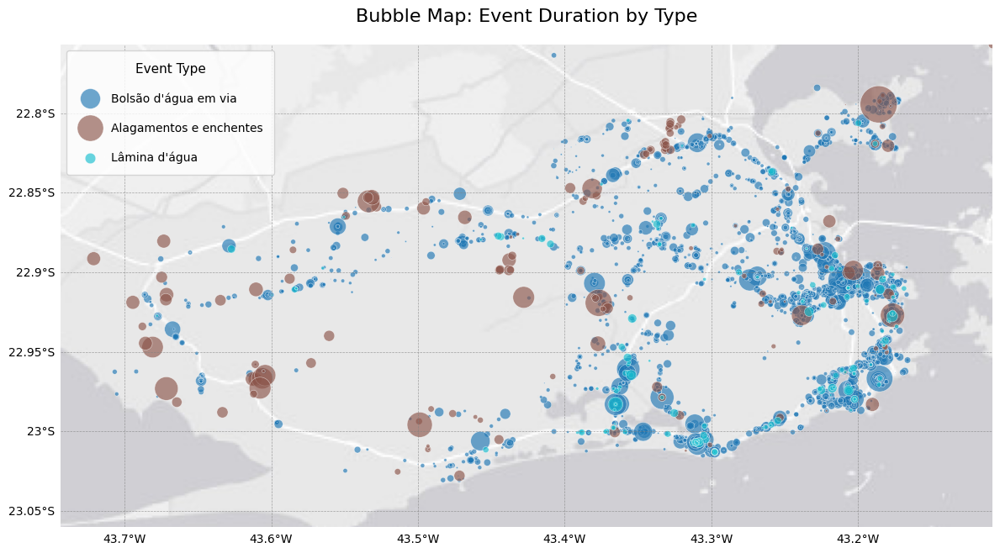

In [16]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.io.img_tiles as cimgt
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.cm as cm
import numpy as np

# --- Custom Tile Class ---
class CustomTiles(cimgt.OSM):
    def __init__(self, url, attribution=None):
        super().__init__()
        self._url_template = url
        self.attribution = attribution or "Tile data attribution not set"

    def _image_url(self, tile):
        x, y, z = tile
        return self._url_template.format(z=z, x=x, y=y, s='a')

# --- Load Neighborhoods and Events ---
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path).to_crs(epsg=3857)

# Convert events to GeoDataFrame
gdf_events = gpd.GeoDataFrame(
    ocorrencias,
    geometry=gpd.points_from_xy(ocorrencias.longitude, ocorrencias.latitude),
    crs="EPSG:4326"
).to_crs(epsg=3857)

# --- Plotting Setup ---
tile_url = "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
tiler = CustomTiles(tile_url, attribution="© Esri, OpenStreetMap contributors")
crs = tiler.crs

fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs})
xmin, ymin, xmax, ymax = gdf_events.total_bounds
padding_x = 1000
ax.set_extent([xmin - padding - 2500, xmax + padding, ymin - padding - 3500, ymax + padding], crs=crs)
ax.add_image(tiler, 10)

# --- Gridlines ---
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=0.5, color='gray', alpha=0.7, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 10}
gl.ylabel_style = {'size': 10}

# --- Colors by Event Type ---
event_types = gdf_events['tipo'].dropna().unique()
cmap = cm.get_cmap('tab10', len(event_types))
color_map = {tipo: cmap(i) for i, tipo in enumerate(event_types)}

# --- Plot each event type with size and color ---
for tipo in event_types:
    subset = gdf_events[gdf_events['tipo'] == tipo]
    duration = subset['duration_minutes'].clip(upper=10000)
    # sizes = (duration / duration.max()) * 500  # scale max size
    sizes = duration / 10  # scale max size

    subset.plot(ax=ax,
                markersize=sizes,
                color=color_map[tipo],
                alpha=0.65,
                edgecolor='white',
                linewidth=0.4,
                transform=crs,
                label=tipo)

# --- Legend ---
ax.legend(title="Event Type", loc="upper left", fontsize=10, title_fontsize=11, frameon=True, borderpad=1, labelspacing=1.5)

# --- Title and Export ---
ax.set_title("Bubble Map: Event Duration by Type", fontsize=16, pad=20)
ax.set_axis_off()
plt.tight_layout()
plt.savefig("maps/bubble_map_by_type.png", dpi=600, bbox_inches='tight')
plt.show()


## 8. Multi-Dimensional & Interactive Dashboards

### Faceted Plots

- Use facet grids to create small multiples by “bairro” or event type for both temporal and spatial plots.

In [17]:
# Faceted scatter map by gravidade
fig_facet_geo_gravidade = px.scatter_geo(ocorrencias, lat='latitude', lon='longitude', facet_col='gravidade', color='tipo',
                                          scope='south america', center={'lat': ocorrencias['latitude'].mean(), 'lon': ocorrencias['longitude'].mean()},
                                          title='Faceted Geospatial Distribution by Gravidade')
fig_facet_geo_gravidade.show()